https://github.com/vrx-/NASA_MUREP

In [1]:
from datetime import datetime
from satpy import Scene, find_files_and_readers
from satpy.writers import get_enhanced_image
from pyresample import create_area_def
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import pandas as pd
#from celluloid import Camera

ModuleNotFoundError: No module named 'satpy'

In [6]:
cd

/mnt/beegfs/home/alexisa2019


In [3]:
ls

Desktop/    Downloads/  NASA Things/  Projects/  Templates/  ondemand/
Documents/  Music/      Pictures/     Public/    Videos/     scratch@


# FL Bay Projection

In [ ]:
files = find_files_and_readers(sensor='olci',
                               start_time=datetime(2022, 3, 23),
                               end_time=datetime(2022, 3, 24),
                               base_dir="Projects/products/GomexData/",
                               reader='olci_l1b')

files
scn = Scene(filenames=files)

scn.load(['true_color'])
scn.show('true_color')

In [ ]:
# How to figure out a good pixel extent

def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance in kilometers between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles. Determines return value units.
    return c * r

In [ ]:
print('Extension of domain in km')
print('top width:', haversine(-82,26,-80,26))
print('bottom width:', haversine(-82,24,-80,24))
print('Mean width:',.5*(haversine(-82,26,-80,26)+haversine(-82,24,-80,24)))
print('height:', haversine(-82,26,-82,24))

In [ ]:
#Resolution of Sentinel: 300 m

print('width pixels:', 201000/300)
print('height pixels:', 222000/300)

In [8]:
# files = find_files_and_readers(sensor='olci',
#                                start_time=datetime(2022, 3, 23, 0),
#                                end_time=datetime(2022, 3, 23, 23),
#                                base_dir="Projects/products/EO:EUM:DAT:0409_2022-03-23-2022-03-24/",
#                                reader='olci_l1b')

# files
# scn = Scene(filenames=files)

# scn.load(['true_color'])
# scn.show('true_color')

my_area = create_area_def('my_area', {'proj': 'lcc', 'lon_0': -91., 'lat_0': 29.5, 'lat_1': 29.5, 'lat_2': 29.5},
#                           width=1200, height=700,
                            width=670, height=740, # from above method
                          area_extent=[-82, 26, -80, 24], units='degrees')
new_scn = scn.resample(my_area)
#generate RGB from true color
rgb = get_enhanced_image(new_scn['true_color'])
#extract projection and lon lat from products
crs = new_scn['true_color'].attrs['area'].to_cartopy_crs()

KeyError: 'platform_name'

In [9]:
files = find_files_and_readers(sensor='olci',
                               start_time=datetime(2022, 3, 23, 0),
                               end_time=datetime(2022, 3, 23, 23),
                               base_dir="Projects/products/LakeOTest/",
                               reader='olci_l1b')

files
scn = Scene(filenames=files)

scn.load(['true_color'])
scn.show('true_color')

my_area = create_area_def('my_area', {'proj': 'lcc', 'lon_0': -91., 'lat_0': 29.5, 'lat_1': 29.5, 'lat_2': 29.5},
                          width=1200, height=700,
                          area_extent=[-82, 26, -80, 24], units='degrees')
new_scn = scn.resample(my_area)
#generate RGB from true color
rgb = get_enhanced_image(new_scn['true_color'])
#extract projection and lon lat from products
crs = new_scn['true_color'].attrs['area'].to_cartopy_crs()

/mnt/beegfs/home/alexisa2019/.conda/envs/myCdom/lib/python3.10/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in log
  return func(*(_execute_task(a, cache) for a in args))
/mnt/beegfs/home/alexisa2019/.conda/envs/myCdom/lib/python3.10/site-packages/satpy/modifiers/angles.py:485: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)


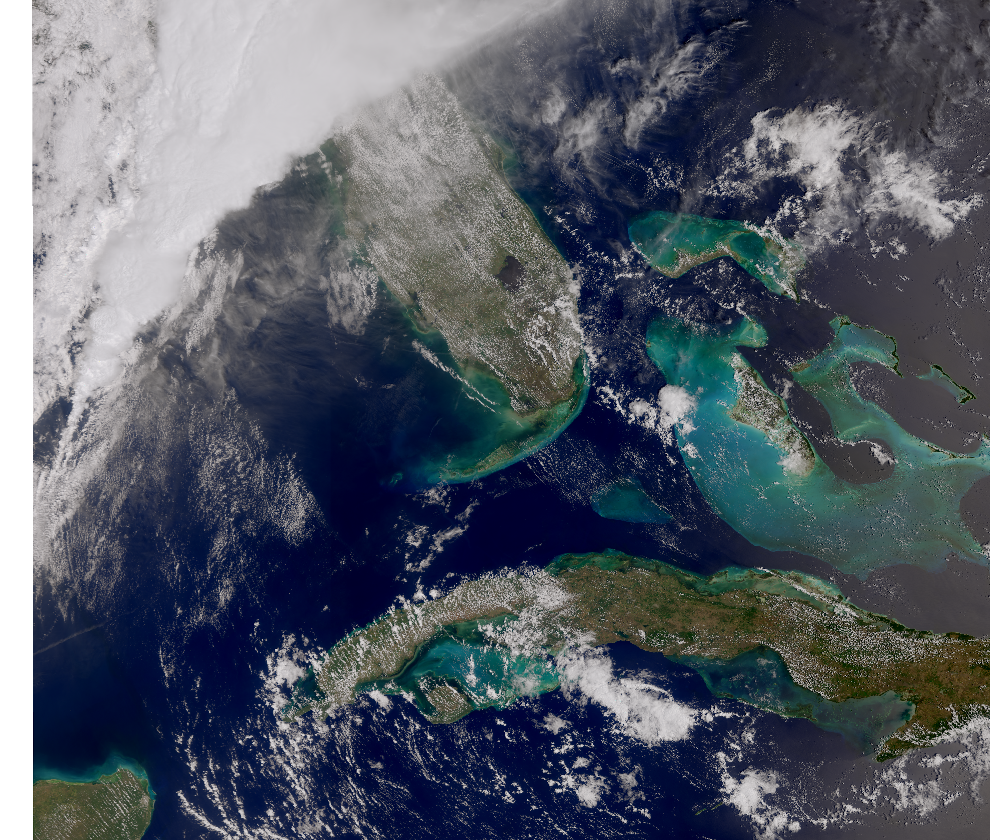

In [11]:
scn.show('true_color')


/mnt/beegfs/home/alexisa2019/.conda/envs/myCdom/lib/python3.10/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in log
  return func(*(_execute_task(a, cache) for a in args))
/mnt/beegfs/home/alexisa2019/.conda/envs/myCdom/lib/python3.10/site-packages/satpy/modifiers/angles.py:485: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.02, 0.85, 'Sentinel 3: 2022-03-24')

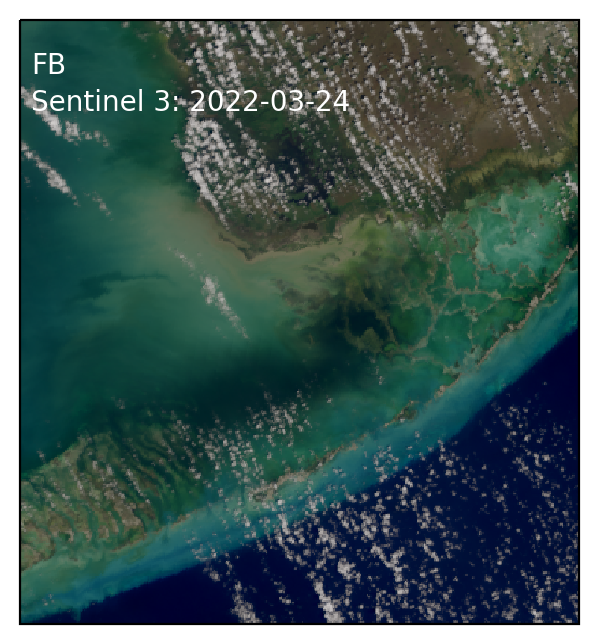

In [10]:
# Plot a tru color map, with stations
fig =  plt.figure(dpi=200)
ax = plt.subplot(projection=crs)
ax.set_extent([-81.5, -80.5, 24.5, 25.5])
rgb.data.plot.imshow(rgb='bands', transform=crs, ax=ax)

ax.set_title('')
ax.text(.02, .91, 'FB', transform=ax.transAxes, color='w')
ax.text(.02, .85, 'Sentinel 3: 2022-03-24', transform=ax.transAxes, color='w')

# GOMEX Projection

In [21]:
files = find_files_and_readers(sensor='olci',
                               start_time=datetime(2022, 3, 23),
                               end_time=datetime(2022, 3, 24),
                               base_dir="Projects/products/LakeOTest/",
                               reader='olci_l1b')

files
scn = Scene(filenames=files)

scn.load(['true_color'])
scn.show('true_color')

my_area = create_area_def('my_area', {'proj': 'lcc', 'lon_0': -91., 'lat_0': 29.5, 'lat_1': 29.5, 'lat_2': 29.5},
                          width=1200, height=700,
                          area_extent=[-92.5, 30.5, -87, 28], units='degrees')
new_scn = scn.resample(my_area)
#generate RGB from true color
rgb = get_enhanced_image(new_scn['true_color'])
#extract projection and lon lat from products
crs = new_scn['true_color'].attrs['area'].to_cartopy_crs()

/mnt/beegfs/home/alexisa2019/.conda/envs/myCdom/lib/python3.10/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in log
  return func(*(_execute_task(a, cache) for a in args))
/mnt/beegfs/home/alexisa2019/.conda/envs/myCdom/lib/python3.10/site-packages/satpy/modifiers/angles.py:485: RuntimeWarning: invalid value encountered in log
  grad_factor = 1. - np.log(grad_factor + 1) / np.log(2)


Text(0.02, 0.85, 'Sentinel 3: 2022-03-24')

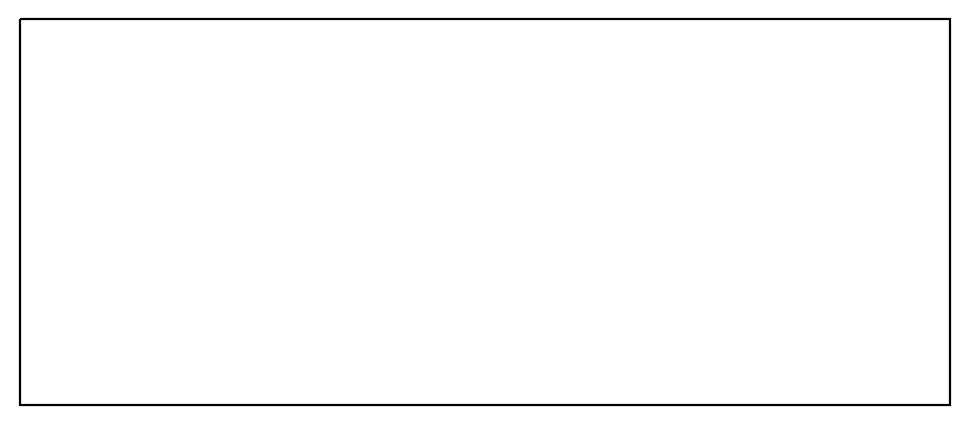

In [22]:
# Plot a tru color map, with stations
fig =  plt.figure(dpi=200)
ax = plt.subplot(projection=crs)
ax.set_extent([-92, -88, 28, 29.5])
rgb.data.plot.imshow(rgb='bands', transform=crs, ax=ax)

ax.set_title('')
ax.text(.02, .91, 'FB', transform=ax.transAxes, color='w')
ax.text(.02, .85, 'Sentinel 3: 2022-03-24', transform=ax.transAxes, color='w')